### Problem:

$$$$



*   $V_{0} = 10$ V
*   $V_{1} = 10sin(\pi x)$ V
*   $V(x,y)$ ?
*   $|E(x,y)|$ ?

$$$$
$$$$
$$$$
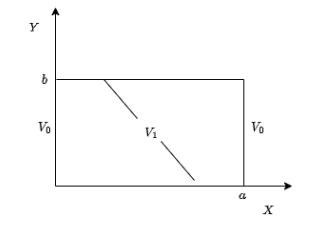


In [1]:
# @title Imports
import numpy as np
import sympy as sp
import plotly.graph_objects as go

### Potential $V(x,y)$
$$$$
$$$$
$$$$
$$ V(x,y)   = \displaystyle\frac{10sin(\pi x)^{2}[sinh(\pi y) + sinh(\pi(2-y))]}{sinh(2\pi)}$$
$$$$
$$\sum_{n=1}^{\infty} \quad\displaystyle\left\{ \begin{matrix} \displaystyle\frac{40 sinh(n\pi x/2)sin(n\pi y/2)}{n\pi sinh(n\pi/2)}+ \displaystyle\frac{40 sinh(n\pi (1-x)/2)sin(n\pi y/2)}{n\pi sinh(n\pi/2)}, & \mbox{se }n\mbox{ é ímpar} \\ 0, & \mbox{se }n\mbox{ é par}  \end{matrix} \right.$$



In [19]:
#@title Potencial Graph
n_max = 400 #@param
n_points = 700 #@param

x, y, n = sp.symbols('x y n')

# Defining the math expressions

V_with_n = (40/sp.pi)*(sp.sin(n*sp.pi*(y)/2)*sp.sinh(n*sp.pi*(x)/2))/(n*sp.sinh(n*sp.pi/2)) + (40/sp.pi)*(sp.sin(n*sp.pi*(y)/2)*sp.sinh(n*sp.pi*(1-x)/2))/(n*sp.sinh(n*sp.pi/2))
V_with_n_f = sp.lambdify((x, y, n), V_with_n, 'numpy')

V_without_n = (10 * sp.sin(sp.pi * x)**2) * (sp.sinh(sp.pi * y) + sp.sinh(sp.pi * (2-y))) / sp.sinh(2*sp.pi)
V_without_n_f = sp.lambdify((x, y), V_without_n, 'numpy')

V_xy = lambda x,y : V_without_n_f(x,y) + sum([0 if(n%2==0) else V_with_n_f(x,y,n) for n in range(1,n_max+1)])

# Dfining the x values and the y values
x_vals = np.linspace(0, 1, n_points)
y_vals = np.linspace(0, 2, n_points)

# Creating the meshgrid using the x values and the y values
X, Y = np.meshgrid(x_vals, y_vals)

# Calcula os valores de Z (V(x,y)) para cada ponto (x,y)

Z = V_xy(X, Y)

# Creating the Figure
fig = go.Figure(data=[go.Surface(z=Z, x=X, y=Y, colorscale='Viridis', colorbar=dict(len=0.4, title={'text': 'V(x,y) (V)', 'side': 'right'}))])

# Defining the Layout
fig.update_layout(title='',
                  scene=dict(
                      xaxis_title='x (m)',
                      yaxis_title='y (m)',
                      zaxis_title='V(x,y) (V)',
                      xaxis_backgroundcolor="rgb(200, 200, 200)",
                      yaxis_backgroundcolor="rgb(200, 200, 200)",
                      zaxis_backgroundcolor="rgb(200, 200, 200)"
                  ),
                  width=900,
                  height=800)

#Showing the graph
fig.show()


### Electric Field Magnitude $|\vec{E}(x,y)|$
$$$$
$$$$
$$$$
$$$$
$$|\vec{E}(x,y)| = \Bigg|-\frac{\partial V(x,y)}{\partial x}\hat{a_{x}} -\frac{\partial V(x,y)}{\partial y}\hat{a_{y}}\Bigg|$$

In [22]:
# @title Gráfico do Módulo do Campo Elétrico
#@title Potencial Graph
n_max = 50 #@param
n_points = 20 #@param

x, y, n = sp.symbols('x y n')

# Defining the math expressions

E_x_with_n = 40*(sp.sin(n*sp.pi*(y)/2)*sp.cosh(n*sp.pi*(x)/2))/(2*sp.sinh(n*sp.pi/2)) - 40*(sp.sin(n*sp.pi*(y)/2)*sp.cosh(n*sp.pi*(1-x)/2))/(2*sp.sinh(n*sp.pi/2))
E_x_with_n_f = sp.lambdify((x, y, n), E_x_with_n , 'numpy')

E_x_without_n = 20 * sp.pi *sp.sin(sp.pi * x)* sp.cos(sp.pi * x) * (sp.sinh(sp.pi * y) + sp.sinh(sp.pi * (2-y))) / sp.sinh(2*sp.pi)
E_x_without_n_f = sp.lambdify((x, y), E_x_without_n, 'numpy')

E_x = lambda x,y : E_x_without_n_f(x,y)  + sum([0 if(n%2==0) else E_x_with_n_f(x,y,n) for n in range(1,n_max+1)])

E_y_with_n = 40*(sp.cos(n*sp.pi*(y)/2)*sp.sinh(n*sp.pi*(x)/2))/(2*sp.sinh(n*sp.pi/2)) + 40*(sp.cos(n*sp.pi*(y)/2)*sp.sinh(n*sp.pi*(1-x)/2))/(2*sp.sinh(n*sp.pi/2))
E_y_with_n_f = sp.lambdify((x, y, n), E_y_with_n, 'numpy')

E_y_without_n = (10 * sp.sin(sp.pi * x)**2) * (sp.cosh(sp.pi * y) - sp.cosh(sp.pi * (2-y))) / sp.sinh(2*sp.pi)
E_y_without_n_f = sp.lambdify((x, y), E_y_without_n, 'numpy')

E_y = lambda x,y : E_y_without_n_f(x,y) + sum([0 if(n%2==0) else E_y_with_n_f(x,y,n) for n in range(1,n_max+1)])

E_xy_module = lambda x,y : np.sqrt(E_x(x,y)**2 + E_y(x,y)**2)

# Dfining the x values and the y values
x_vals = np.linspace(0, 1, n_points)
y_vals = np.linspace(0, 2, n_points)

# Creating the meshgrid using the x values and the y values
X, Y = np.meshgrid(x_vals, y_vals)

# Calcula os valores de Z (V(x,y)) para cada ponto (x,y)

Z = E_xy_module(X, Y)

# Creating the Figure
fig = go.Figure(data=[go.Surface(z=Z, x=X, y=Y, colorscale='Viridis', colorbar=dict(len=0.4, title={'text': '|E(x,y)| (V/m)', 'side': 'right'}))])

# Defining the Layout
fig.update_layout(title='',
                  scene=dict(
                      xaxis_title='x (m)',
                      yaxis_title='y (m)',
                      zaxis_title='|E(x,y)| (V/m)',
                      xaxis_backgroundcolor="rgb(200, 200, 200)",
                      yaxis_backgroundcolor="rgb(200, 200, 200)",
                      zaxis_backgroundcolor="rgb(200, 200, 200)"
                  ),
                  width=900,
                  height=800)

#Showing the graph
fig.show()
